In [3]:
# Import necessary libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
from utils import *
from harris.harris import *

Images loaded successfully!


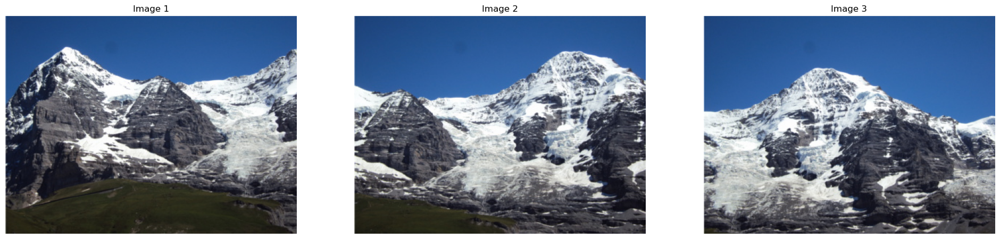

In [4]:
# Load and Display Images
path = "./data/hill"
images = load_images(path) # Loads images into an array

In [5]:
def detect_and_compute_keypoints(img, useHarris=False):
    """
    Detect keypoints and compute descriptors for each image using SIFT.
    """
    keypoints = []
    descriptors = []

    sift = cv2.SIFT_create()

    # convert image to grayscale for harris
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    if useHarris:
        y, x, m = harris(img, 2000)
        print(f"Number of Harris corners detected: {len(x)}")
        keypoints = [cv2.KeyPoint(float(x[i]), float(y[i]), size=10) for i in range(len(x))]
        _, descriptors = sift.compute(img, keypoints)
    else:
        keypoints = sift.detect(img, None)
        keypoints, descriptors = sift.compute(img, keypoints)
    
    return keypoints, descriptors

In [6]:
def stitch_images(img1, img2, kp1, kp2, matches):
    """
    Stitch two images together using matched keypoints and RANSAC to find homography.
    This version adds padding based on detected alignment (left or right).
    """
    # Extract matched keypoints
    img1_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    img2_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
    
    # Compute homography matrix using RANSAC
    H, mask = cv2.findHomography(img1_pts, img2_pts, cv2.RANSAC, 5.0)
    img1_warped, img2_padded = warpPerspectivePadded(img1, img2, H)
    stitched_image = masking(img1_warped, img2_padded, 0.5)
    result = np.uint8(stitched_image)
    
    return result

In [7]:
def create_panorama(images, useHarris=False):
    """
    Create a panorama from a list of images.
    """
    stitched_image = images[0]  # Start with the first image
    for i in range(1, len(images)):
        print(f"Stitching image {i-1} and {i}...")

        if useHarris:
            keypoints1, descriptors1 = detect_and_compute_keypoints(stitched_image, True)
            keypoints2, descriptors2 = detect_and_compute_keypoints(images[i], True)
        else:
            keypoints1, descriptors1 = detect_and_compute_keypoints(stitched_image)
            keypoints2, descriptors2 = detect_and_compute_keypoints(images[i])
        
        # Match features
        matches = match_features(descriptors1, descriptors2)
        print(f"Number of good matches between stitched image and image {i}: {len(matches)}")

        draw_matches(stitched_image, images[i], keypoints1, keypoints2, matches, num_matches=30)
        
        # Stitch the current pair of images
        stitched_image = stitch_images(stitched_image, images[i], keypoints1, keypoints2, matches)
    return stitched_image


Stitching image 0 and 1...
Number of good matches between stitched image and image 1: 506


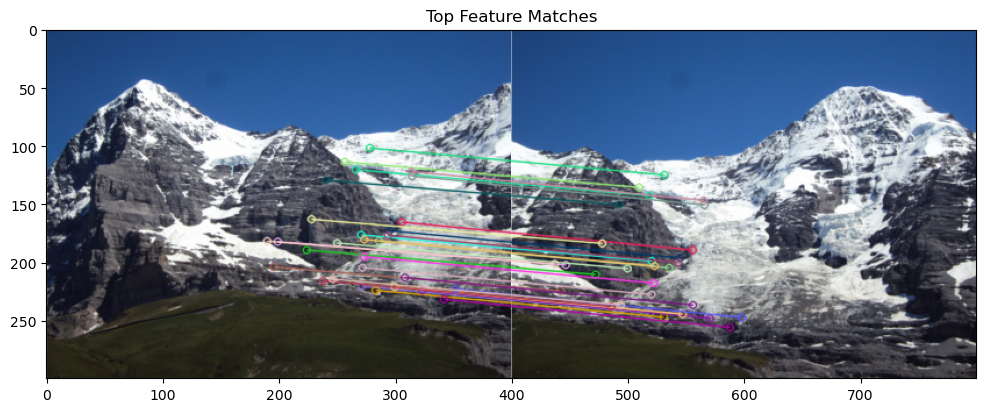

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 690


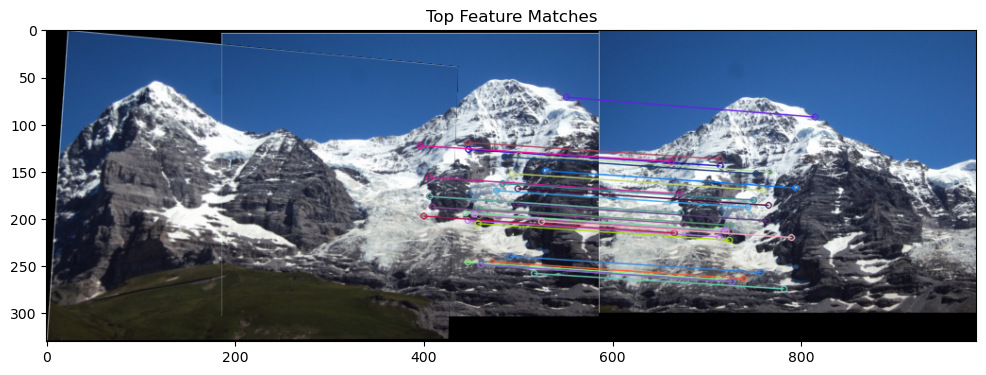

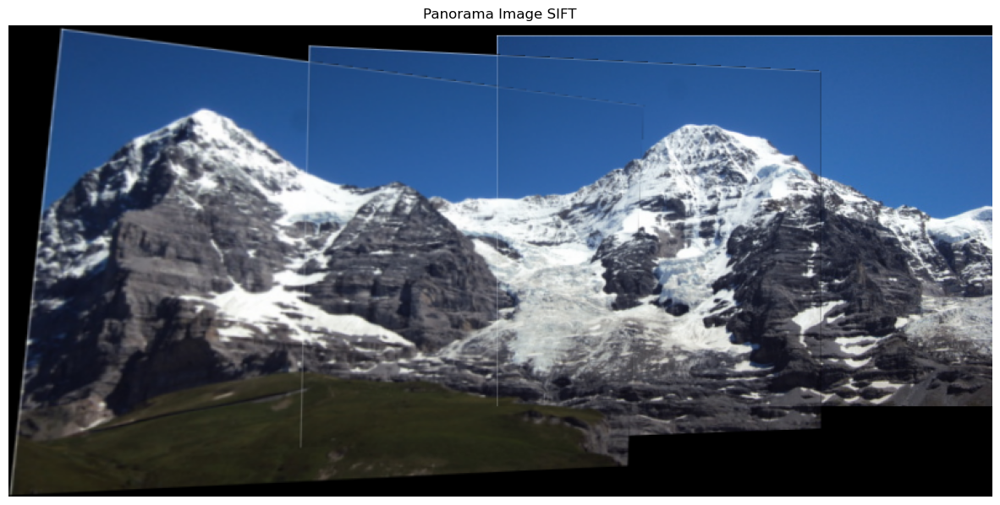

Stitching image 0 and 1...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 1: 622


/home/jackg/dev/EECE5554/LAB5/harris/harris.py:93: RuntimeWarning: invalid value encountered in sqrt
  sqrt_term = np.sqrt(B**2 - 4*(IxIx * IyIy - IxIy**2))


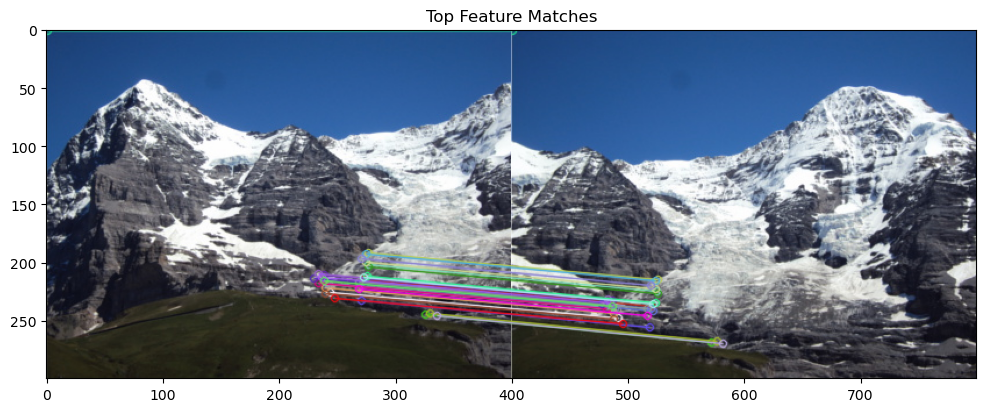

Stitching image 1 and 2...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 2: 823


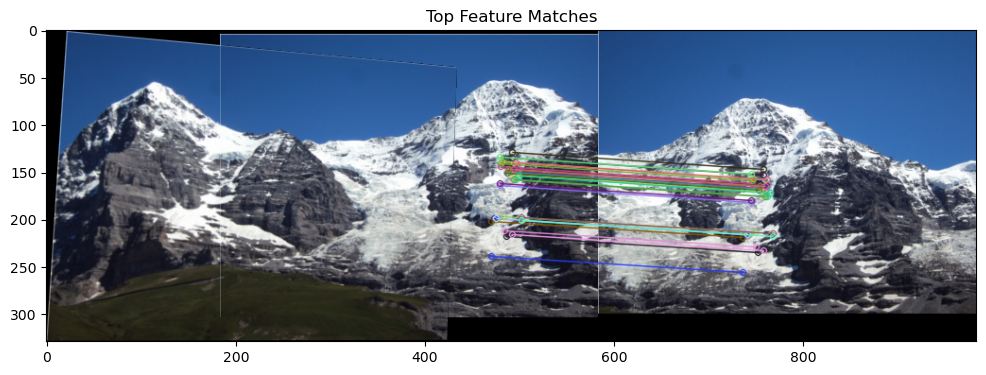

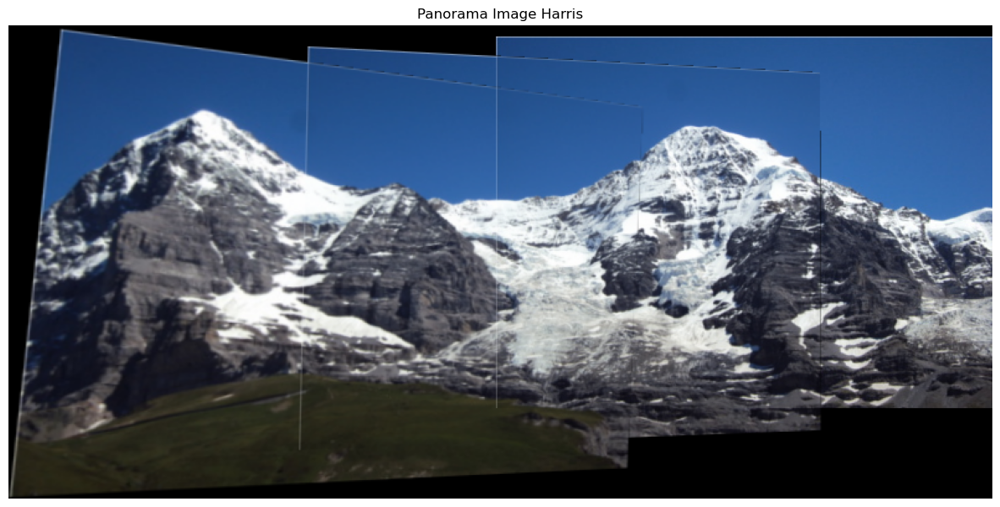

In [8]:
panorama = create_panorama(images)

# Display the final panorama
plt.figure(figsize=(15, 10))
plt.imshow(panorama)
plt.title("Panorama Image SIFT")
plt.axis("off")
plt.show()

panorama = create_panorama(images, True)

# Display the final panorama
plt.figure(figsize=(15, 10))
plt.imshow(panorama)
plt.title("Panorama Image Harris")
plt.axis("off")
plt.show()

First we test the example code with the example images to get a baseline.

Using SIFT, we find that stiching images 1 and 2 gives us 506 good matches,
and stitching images 2 and 3 gives us 690 good matches.

Using Harris:
- Images 1-2 Stitch: 22 good matches
- Images 2-3 Stich: 47 good matches

This was using the base parameters for the harris feature detector. 
Next we ran experiments to find the best parameters for the harris detector.

First, we increased the maximum amount of interest points (corners), N, that can be returned from 100-500 and got the following results:
- Images 1-2 Stitch: 122 good matches
- Images 2-3 Stich: 210 good matches

These results are good, but are still not close to SIFTs values, so we try again with N=1000.
- Images 1-2 Stitch: 275 good matches
- Images 2-3 Stich: 423 good matches

We finally found that N=2000 gives us acceptable values of:
- Images 1-2 Stitch: 622 good matches
- Images 2-3 Stich: 823 good matches

Now that we have implemented the harris detector into the code succesfully, we can begin analyzing our own images. First we start of images on Northeastern campus of a mural.

Loading 50% overlap mural pictures...
Images loaded successfully!


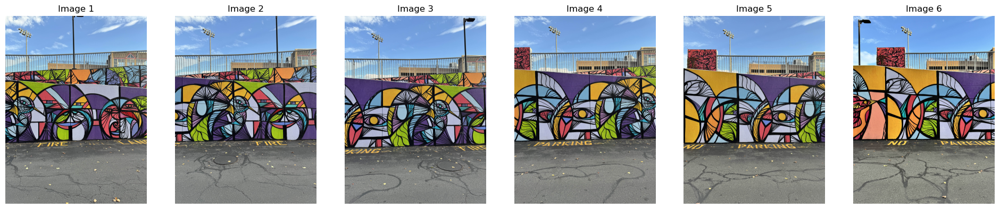

In [9]:
path = "./data/mural50"
print("Loading 50% overlap mural pictures...")
images = load_images(path) # Loads images into an array
#we need to resize the images to make it more efficient
for i in range(len(images)):
    images[i] = cv2.resize(images[i], (1000, 1333))

Stitching image 0 and 1...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 1: 619


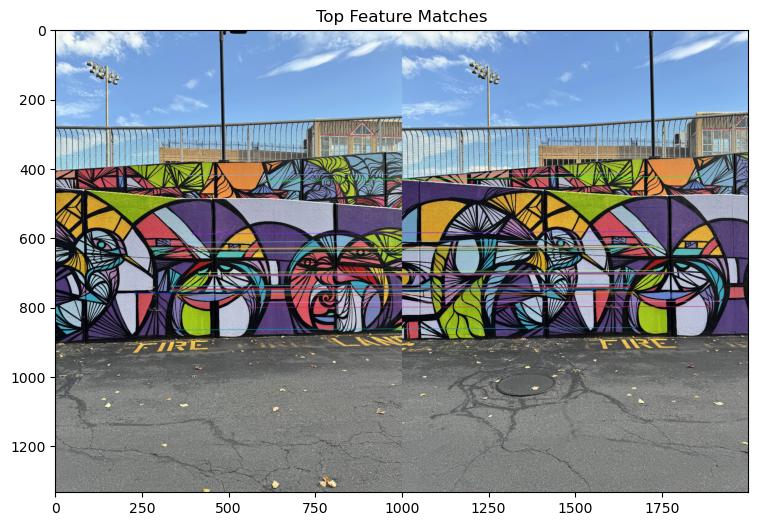

Stitching image 1 and 2...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 2: 631


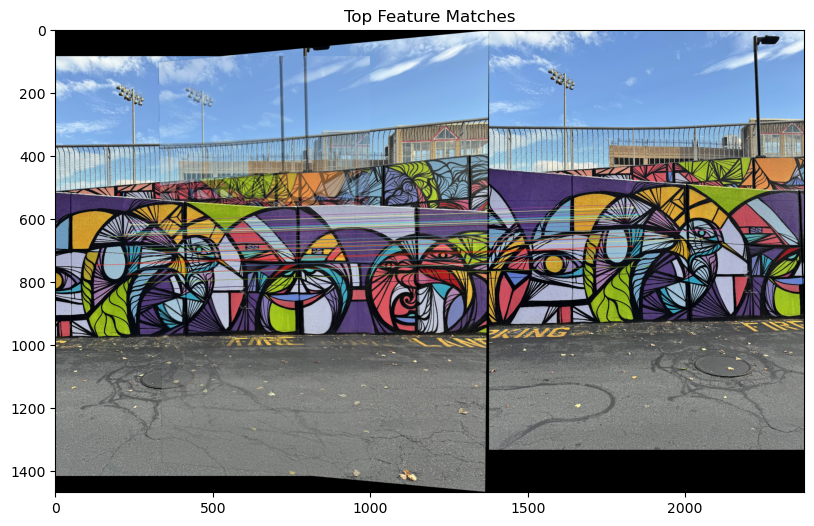

Stitching image 2 and 3...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 3: 629


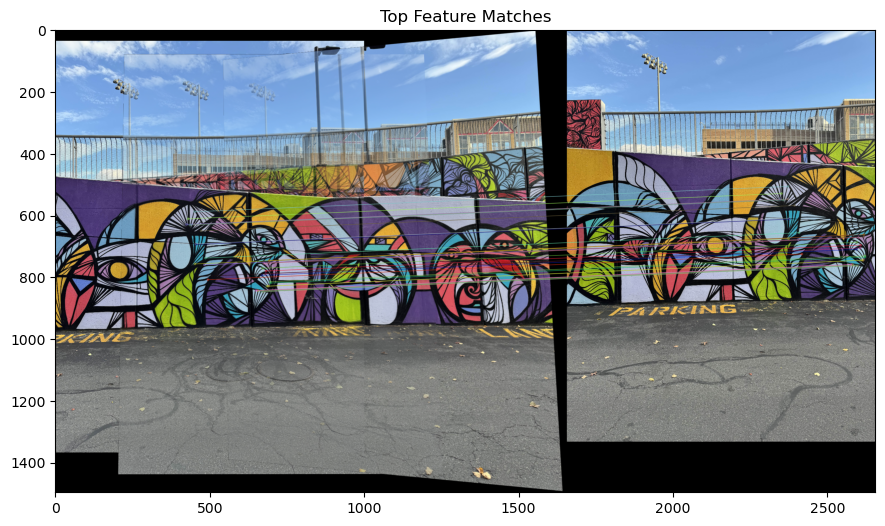

Stitching image 3 and 4...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 4: 666


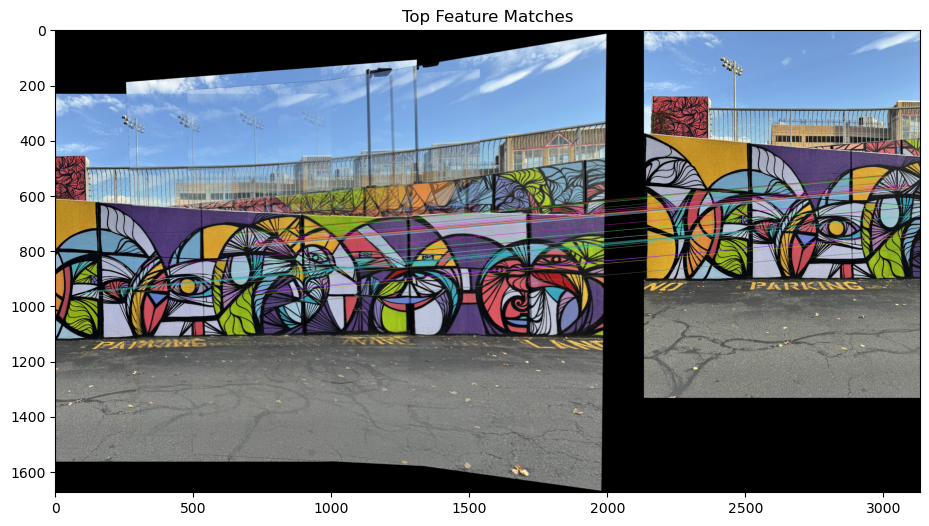

Stitching image 4 and 5...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 5: 651


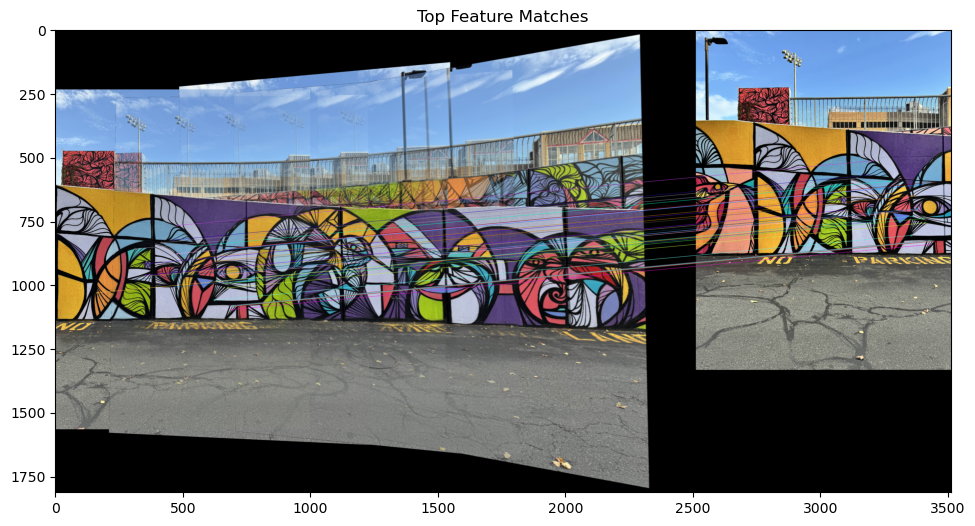

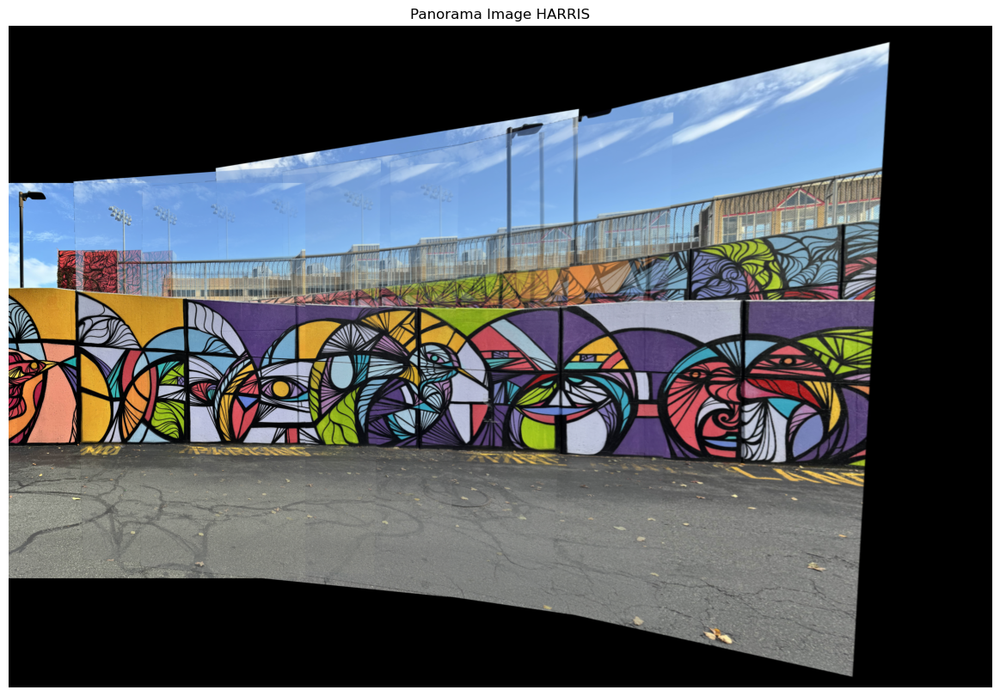

In [10]:
panorama = create_panorama(images, True)

# Display the final panorama
plt.figure(figsize=(15, 10))
plt.imshow(panorama)
plt.title("Panorama Image HARRIS")
plt.axis("off")
plt.show()

The images above were taken around 50% apart from each other, 
which means that 50% of each image should overlap with the images before and after. 

We can see that the quality of the panoramic image for the mural is very good.
The algorithim succesfully stitched all the images together.

The following lists the flow of good matches as we stitched more and more images.
619 --> 631 --> 629 --> 666 --> 651
As we can see, the amount of matches stayed very consistent as we went through all the images, 
although most matches are on the mural.

As the sky is difficult to find features and corners on, the algorithim has a much harder time stitching 
the sky into the pano, which is shown in the multiple lamp posts and blurry fence. 
We can also see that the images were not taken directly parallel to each other as the text on the asphalt
is angle slightly differently which can also add to the error in the sky.

Loading brick pictures...
Images loaded successfully!


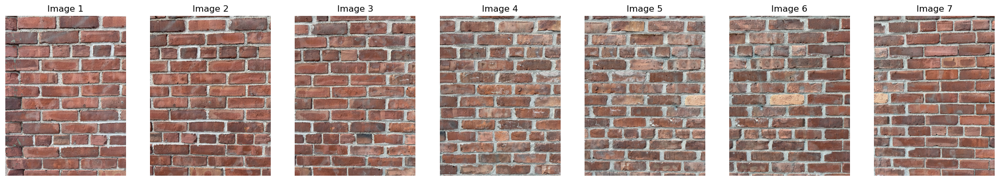

In [11]:
path = "./data/brick"
print("Loading brick pictures...")
images = load_images(path) # Loads images into an array
#we need to resize the images to make it more efficient
for i in range(len(images)):
    images[i] = cv2.resize(images[i], (1000, 1333))

Stitching image 0 and 1...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 1: 429


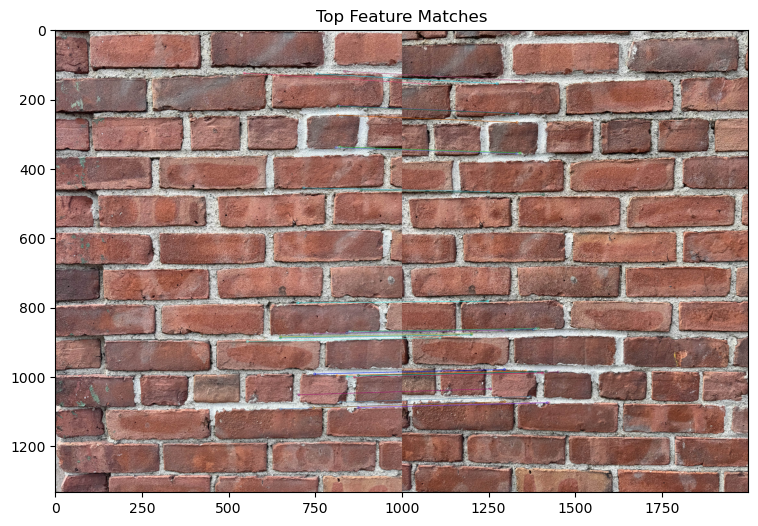

Stitching image 1 and 2...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 2: 553


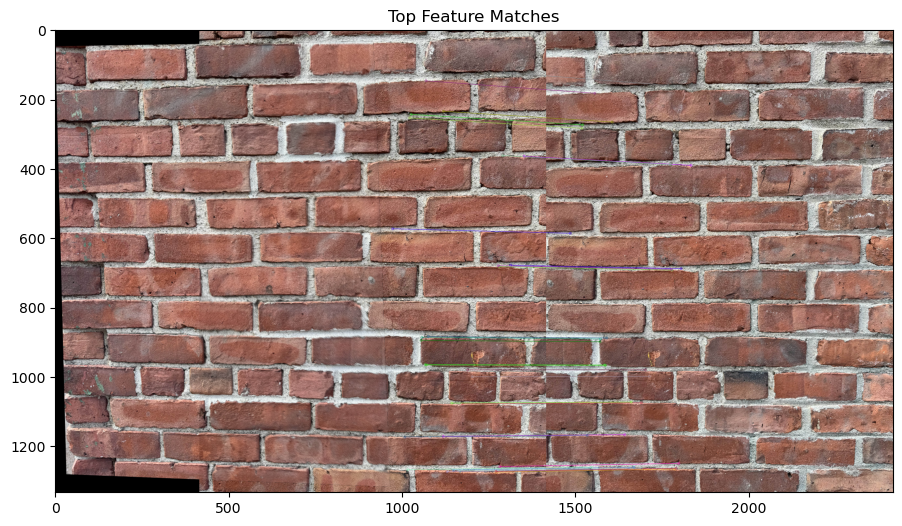

Stitching image 2 and 3...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 3: 418


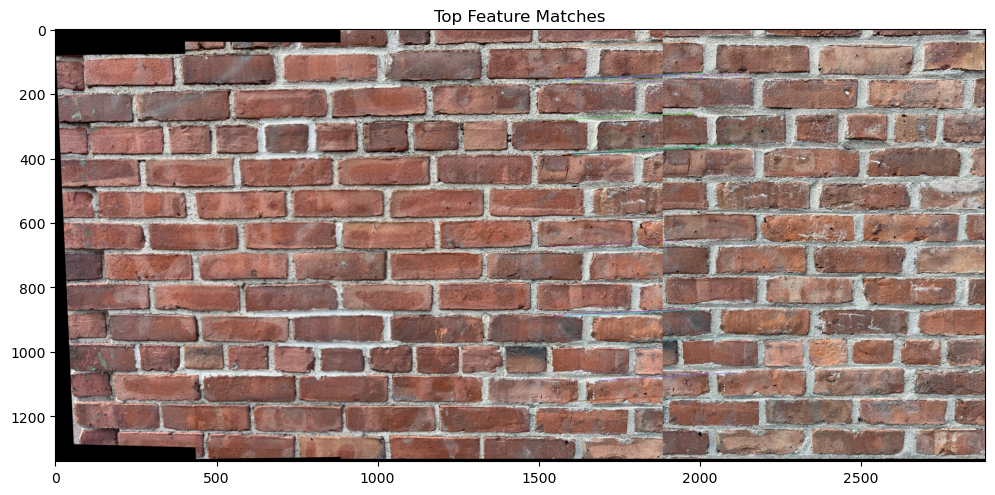

Stitching image 3 and 4...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 4: 440


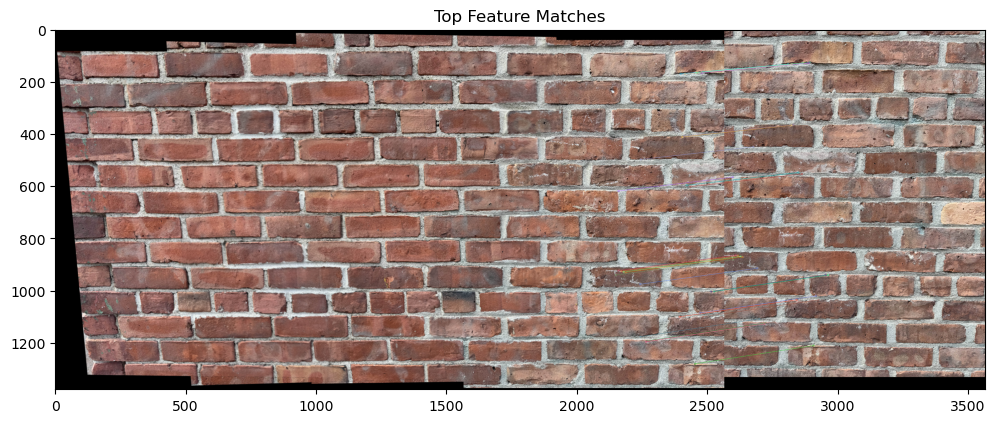

Stitching image 4 and 5...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 5: 558


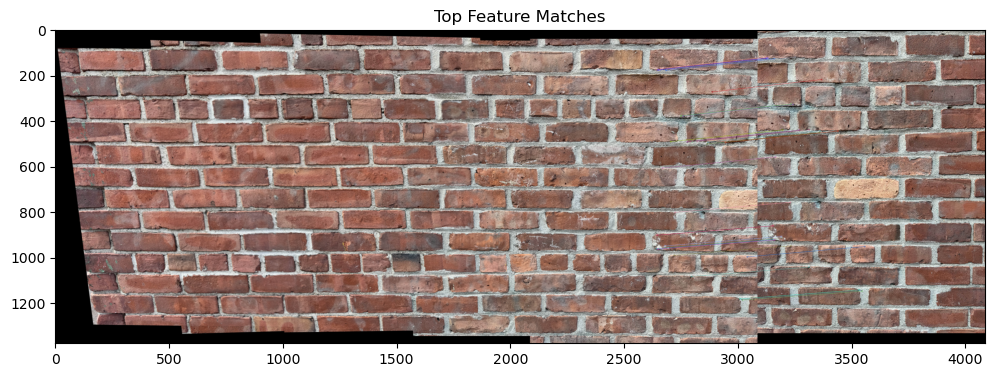

Stitching image 5 and 6...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 6: 514


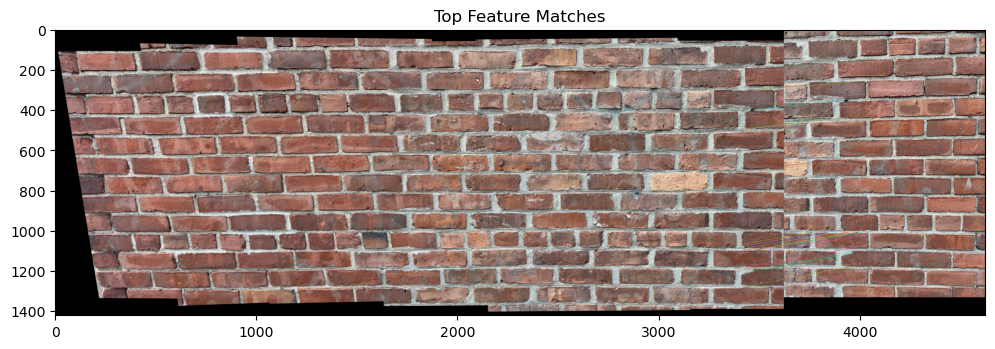

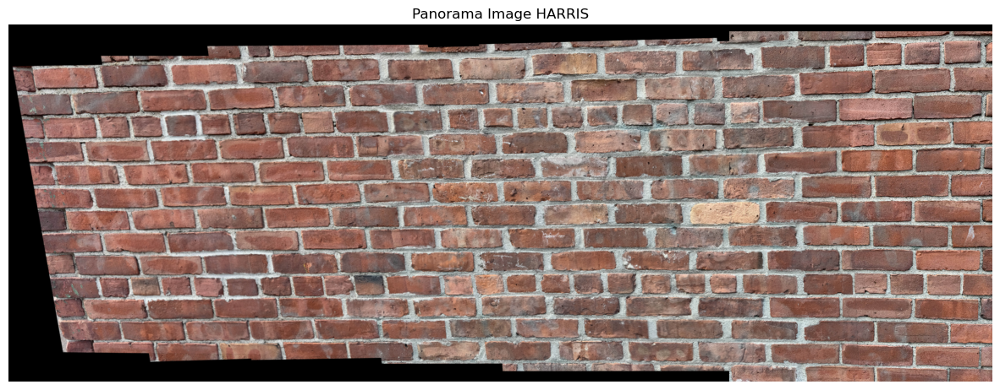

In [12]:
panorama = create_panorama(images, True)

# Display the final panorama
plt.figure(figsize=(15, 10))
plt.imshow(panorama)
plt.title("Panorama Image HARRIS")
plt.axis("off")
plt.show()

These images of the brick wall with 50% overlap show to also work 
with the Harris corner detector succesfully as shown by the good matches
from each consecutive stitch:
429 --> 553 --> 418 --> 442 --> 566 --> 520
These good matches show that the Harris detector is even able to find
corners when there is a similar pattern between images. As shown by the
displayed matches, most of the matches happen on the edges between the brick
and the mortar. 

Loading mural pictures...
Images loaded successfully!


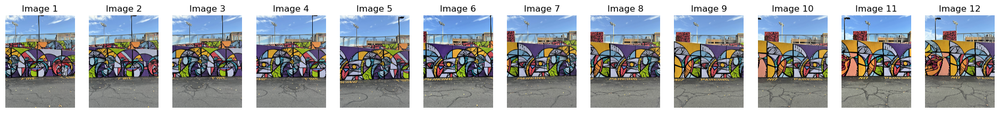

In [13]:
path = "./data/mural"
print("Loading mural pictures...")
images = load_images(path) # Loads images into an array
#we need to resize the images to make it more efficient
for i in range(len(images)):
    images[i] = cv2.resize(images[i], (1000, 1333))

Stitching image 0 and 1...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 1: 780


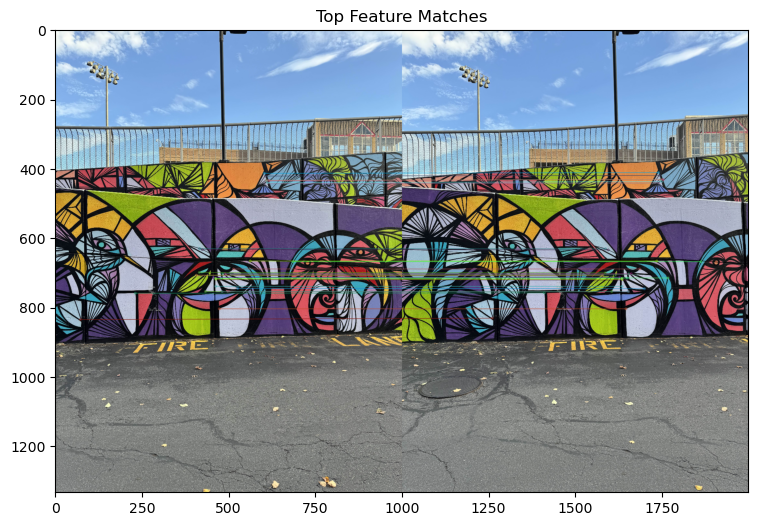

Stitching image 1 and 2...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 2: 664


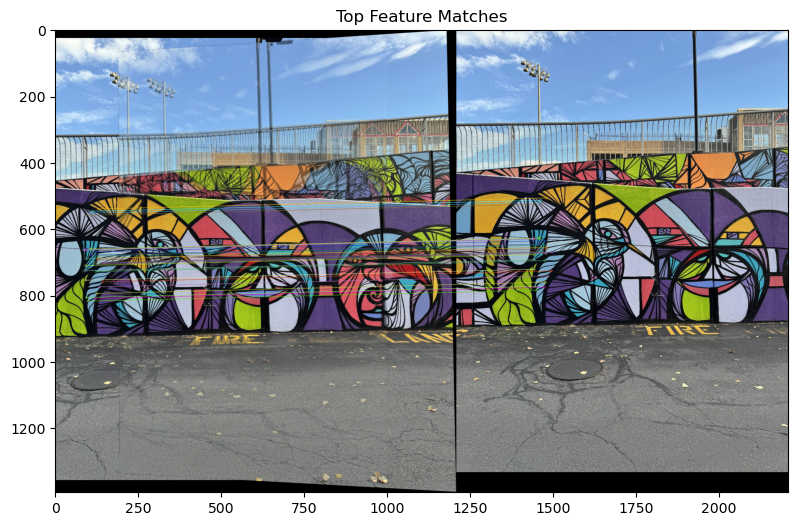

Stitching image 2 and 3...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 3: 690


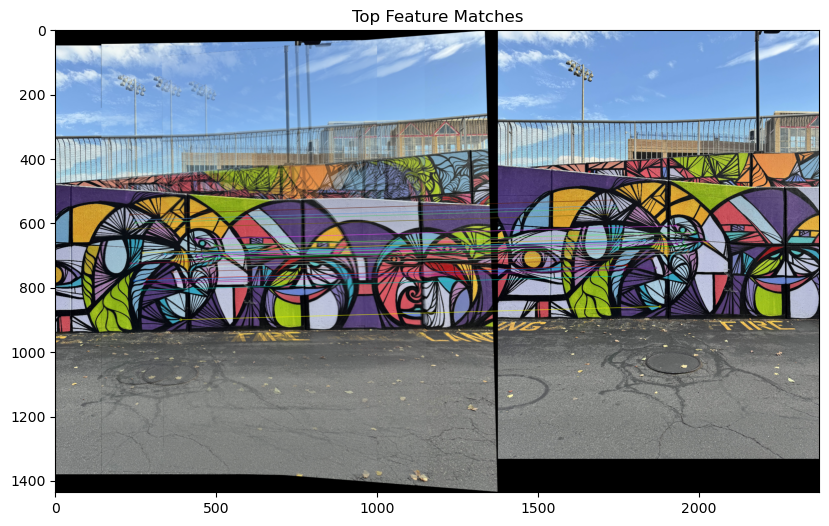

Stitching image 3 and 4...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 4: 741


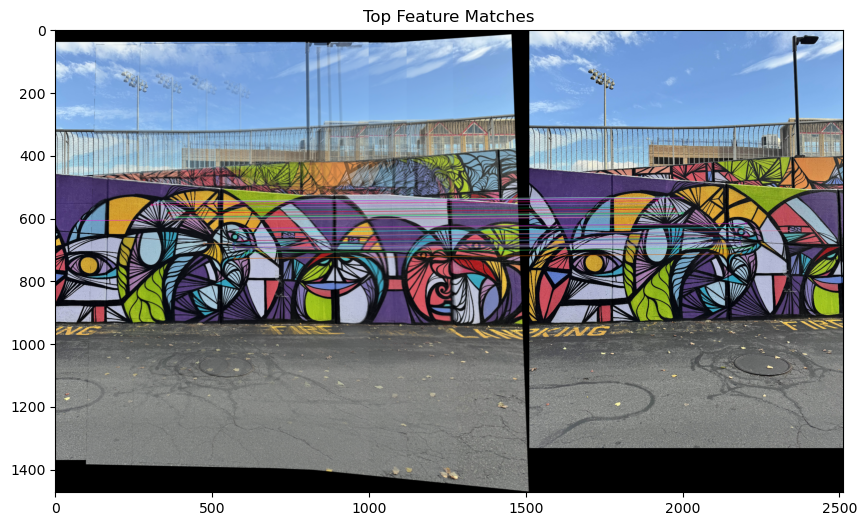

Stitching image 4 and 5...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 5: 744


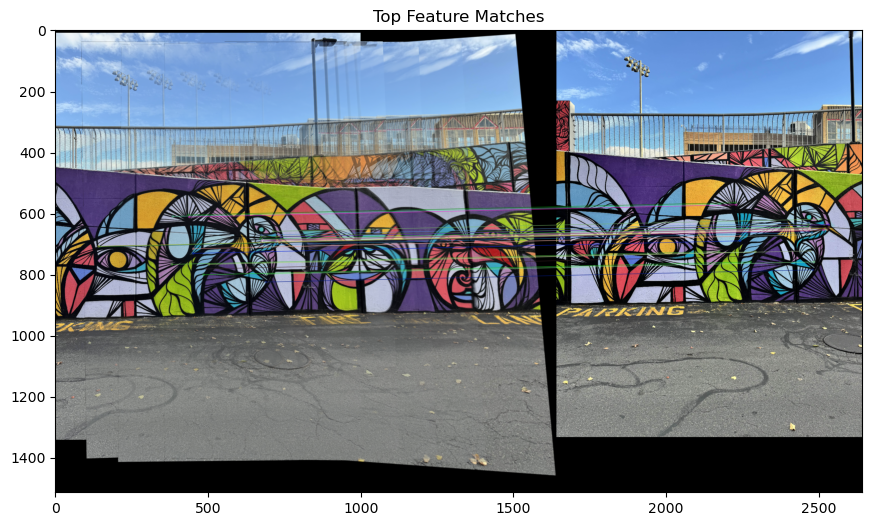

Stitching image 5 and 6...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 6: 853


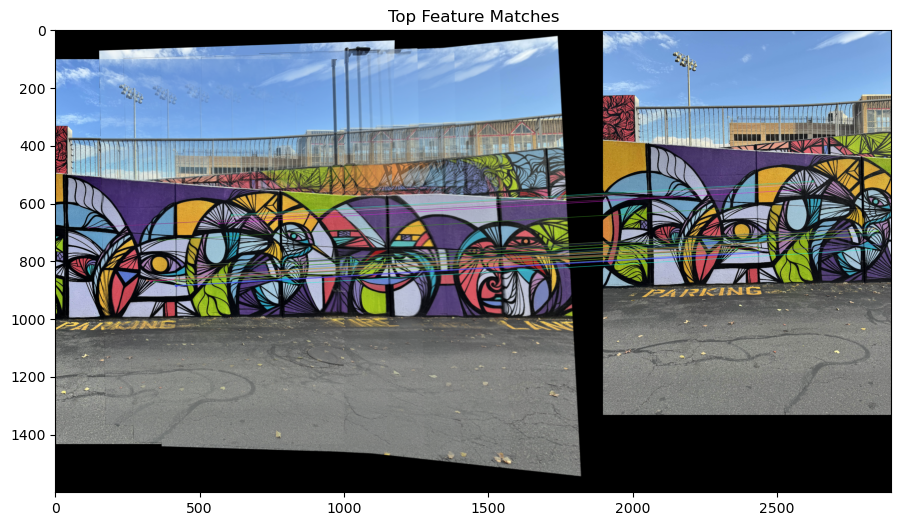

Stitching image 6 and 7...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 7: 772


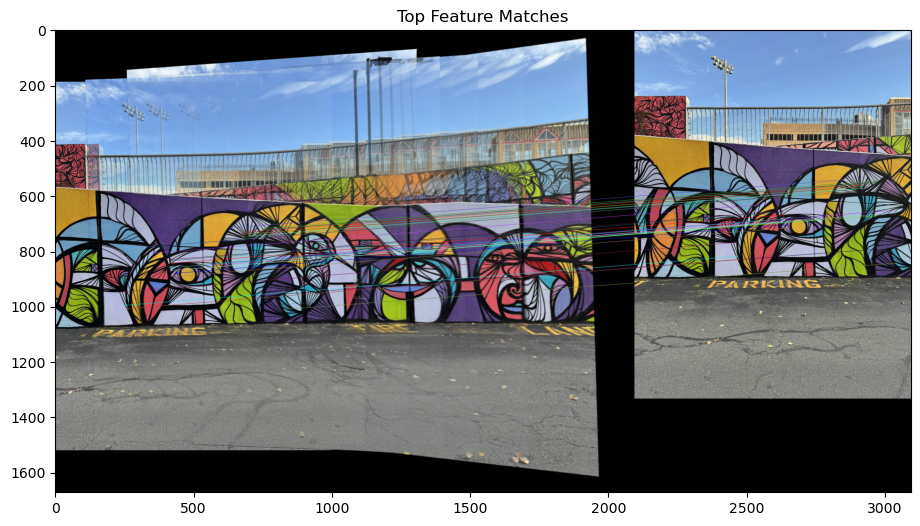

Stitching image 7 and 8...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 8: 797


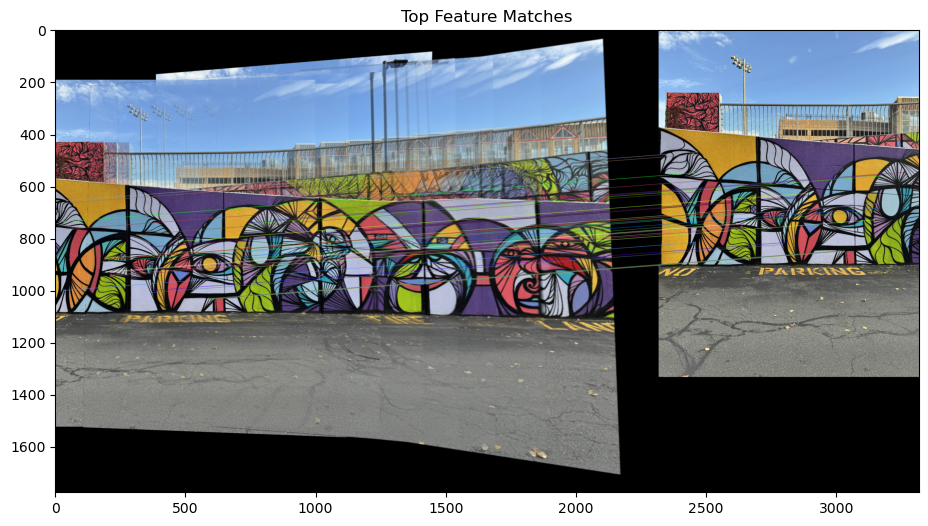

Stitching image 8 and 9...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 9: 689


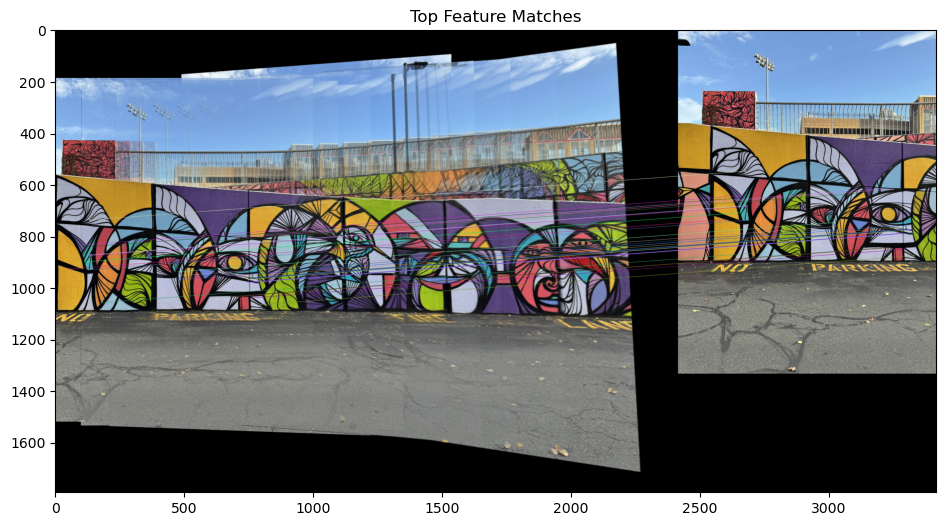

Stitching image 9 and 10...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 10: 590


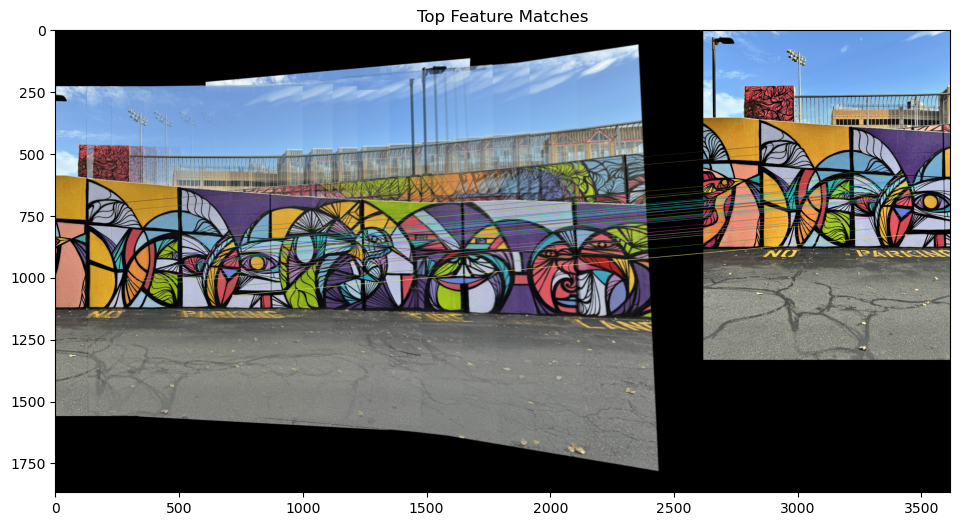

Stitching image 10 and 11...
Number of Harris corners detected: 2000
Number of Harris corners detected: 2000
Number of good matches between stitched image and image 11: 506


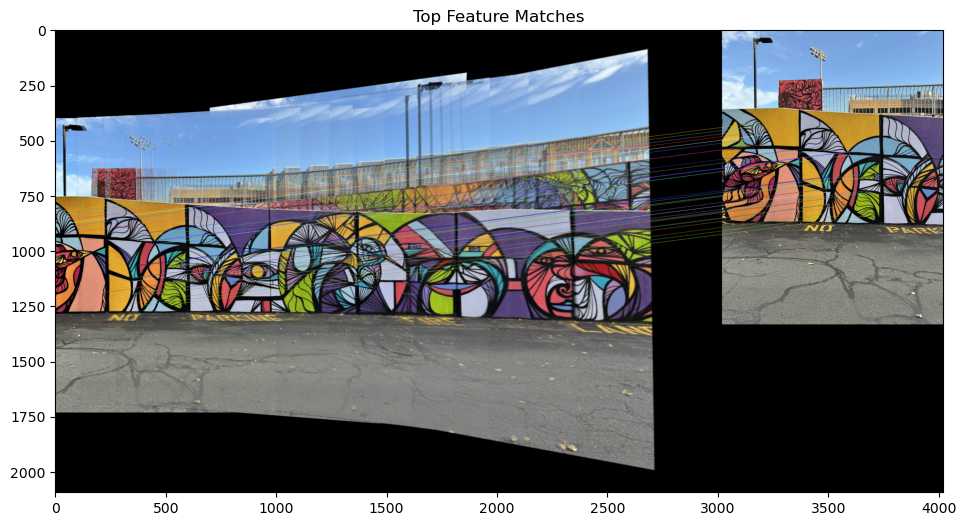

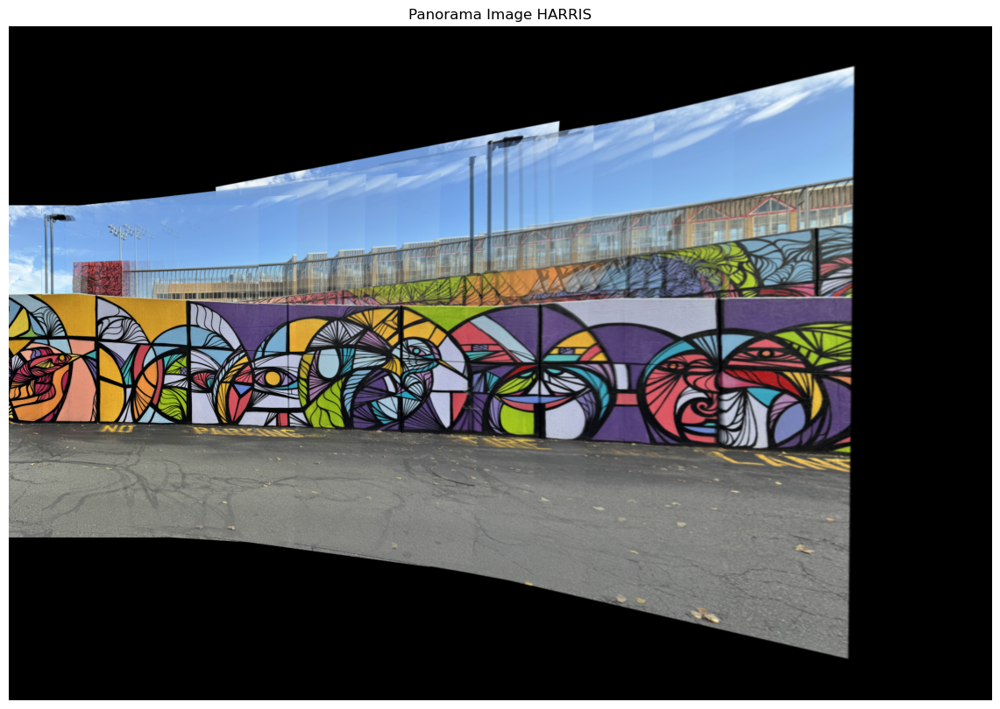

In [14]:
panorama = create_panorama(images, True)

# Display the final panorama
plt.figure(figsize=(15, 10))
plt.imshow(panorama)
plt.title("Panorama Image HARRIS")
plt.axis("off")
plt.show()

Finally, we can see that the pano with images taken only 15% apart from each other gives us another high quality image of the mural but the sky still is distorted. We can also see that the next on the ground looks better, which is most likely due to because the angle between these pictures changed less then when we had fewer pictures. The sky is still distorted and shows more duplicates of the buildings and lamp posts which also probably occurs due to more pictures being taken to create this pano then the previous one. 